# Dataset testing

### This file is an addition to the report. It motivates and shows the steps and tests undertaking to achieve the results.

In [17]:
import cv2
import matplotlib.pyplot as plt
import json
import matplotlib.pyplot as plt
from tifffile import tifffile 
import json
from collections import Counter
from Dataset import LargeRocksDataset
from utils import *
import random
import os
import torch
from torchvision import transforms


## 1. Pre-processing

We start by visualising the train/test split inherent to the json dataset:

In [4]:
label_file = "large_rock_dataset.json"

with open(label_file, 'r') as f:
    data = json.load(f)

dataset =data['dataset']
sample_info = dataset[10]
splits = [tile.get('split', 'train') for tile in dataset]  # Default to 'train' if missing
split_counts = Counter(splits)


for split, count in split_counts.items():
    print(f"{split.capitalize()}: {count} images")
    print(f"Percentage: {count / len(splits) * 100:.2f}%")

Train: 640 images
Percentage: 64.52%
Test: 352 images
Percentage: 35.48%


64 % is a bit low. We therefore will use 10% of images from the test split for validation.

### 2. Converting to YOLO Format

To process the images and use the desired format, the provided `large_rock_dataset.json` had to be formated. For this processing, `Dataset.py` was created. 


### Dataset.py:

This code defines a class `LargeRocksDataset` that processes a dataset containing images and annotations, converts them to the YOLOv8 format, splits them into training, validation, and test sets, and performs several operations to ensure dataset integrity and consistency.

#### Functions:

1. **`__init__`**: Initializes the dataset class, setting paths for images, labels, and outputs, and defining dataset split percentages and whether combined RGB and hillshade images should be created.
   
2. **`_convert_bbox`**: Converts bounding box annotations into YOLOv8 format: `[class_id, x_center, y_center, width, height]`.

3. **`process_dataset`**: Processes the dataset by creating necessary directories, loading annotations, adjusting the dataset split, and converting the images and labels into the YOLO format.

4. **`remove_duplicates_in_labels`**: Traverses the label files and removes duplicate bounding box annotations, preserving the original order.

5. **`check_images_and_label_size`**: Verifies if the number of images matches the number of annotations, reporting missing or extra images.

6. **`print_actual_split`**: Prints the actual distribution of images across the training, validation, and test splits, along with the percentages.

### utils.py:

This Python file contains functions for manipulating, visualizing, and comparing satellite image data, specifically combining RGB and hillshade images, plotting combinations with bounding boxes, and comparing original and YOLO-format bounding boxes for image annotations.

#### Functions:

1. **`combine_rgb_hillshade`**: Combines RGB images and hillshade images into a 4-channel image and saves them in the output folder.

2. **`plot_rgb_hillshade_combinations`**: Selects 5 random images, displays the original RGB images alongside modified versions where each RGB band is replaced by hillshade, and shows the results.

3. **`plot_images_with_comparison`**: Compares original bounding boxes from annotations with YOLO-format bounding boxes on three types of images: RGB, DSM, and Hillshade.

4. **`plot_random_combinations_with_bboxes`**: Selects 5 random images, compares their original RGB version with YOLO-processed versions, and combines them with hillshade while displaying bounding boxes from YOLO annotations.

The following cell provides the yolo format the desired data. *RGBHS* represents combined RGB and HillShade data (reasons can either be found in the report or in the later section), *RGB* only RGB. The **combined_rgb_hillshade_patches** folder comes from running the `combine_rgb_hillshade` file. (Uncomment it if necessary in the following cell). 
The split is [80,10,10] by default -  corresponding to train,val,test. This can also be played with.

In [5]:
Combine_RGB_Hillshade = True

In [6]:
rgb_folder = "swissImage_50cm_patches"
hillshade_folder = "swissSURFACE3D_hillshade_patches"
    
if Combine_RGB_Hillshade == True:
    output_folder = "combined_rgb_hillshade_patches"
    combine_rgb_hillshade(rgb_folder, hillshade_folder, output_folder)


100%|██████████| 992/992 [00:07<00:00, 135.14it/s]


In [7]:
## RGB combined w/ Hillshade
image_folder = "combined_rgb_hillshade_patches"  # Path to swissImage_50cm_patches or equivalent
label_file = "large_rock_dataset.json"  # JSON file with annotations
output_path = "YOLO_RGBHS"  # Directory to save processed dataset

rgb_hs_rocks_dataset = LargeRocksDataset(image_folder, label_file, output_path,split=[75,15,10],combined_rgb_hillshade=True)
if not os.path.exists(output_path):
    rgb_hs_rocks_dataset.process_dataset()
    rgb_hs_rocks_dataset.remove_duplicates_in_labels()
else:
    print(f"{output_path} dataset already exists. Skipping dataset creation.")
rgb_hs_rocks_dataset.print_actual_split()

/Users/janclevorn/miniconda3/envs/IPEO/lib/python3.11/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/Users/janclevorn/miniconda3/envs/IPEO/lib/python3.11/site-packages/rasterio/__init__.py:366: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  dataset = writer(


Dataset (combined_rgb_hillshade_patches) converted to YOLO format with train/val/test splits at YOLO_RGBHS
----------------------------------------
YOLO_RGBHS/labels/val
Duplicates removed in file: YOLO_RGBHS/labels/val/2626_1102_3_0.txt
YOLO_RGBHS/labels/train
Duplicates removed in file: YOLO_RGBHS/labels/train/2626_1102_2_0.txt
Duplicates removed in file: YOLO_RGBHS/labels/train/2588_1133_0_2.txt
Duplicates removed in file: YOLO_RGBHS/labels/train/2704_1127_3_3.txt
Duplicates removed in file: YOLO_RGBHS/labels/train/2588_1133_1_2.txt
Duplicates removed in file: YOLO_RGBHS/labels/train/2582_1127_0_1.txt
Duplicates removed in file: YOLO_RGBHS/labels/train/2598_1132_1_3.txt
Duplicates removed in file: YOLO_RGBHS/labels/train/2598_1132_0_3.txt
YOLO_RGBHS/labels/test
----------------------------------------
*** YOLO_RGBHS Dataset Split ***
Train set: 729 images - 73.49%
Validation set: 114 images - 11.49%
Test set: 149 images - 15.02%
----------------------------------------


In [8]:
## RGB only
image_folder = "swissImage_50cm_patches"  # Path to swissImage_50cm_patches or equivalent
output_path = "YOLO_RGB"  # RGB Directory 

rgb_rocks_dataset = LargeRocksDataset(image_folder, label_file, output_path,split=[75,15,10])
if not os.path.exists(output_path):
    rgb_rocks_dataset.process_dataset()
    rgb_rocks_dataset.remove_duplicates_in_labels()
else:
    print("YOLO dataset already exists. Skipping dataset creation.")
rgb_rocks_dataset.print_actual_split()



Dataset (swissImage_50cm_patches) converted to YOLO format with train/val/test splits at YOLO_RGB
----------------------------------------
YOLO_RGB/labels/val
Duplicates removed in file: YOLO_RGB/labels/val/2626_1102_3_0.txt
YOLO_RGB/labels/train
Duplicates removed in file: YOLO_RGB/labels/train/2626_1102_2_0.txt
Duplicates removed in file: YOLO_RGB/labels/train/2588_1133_0_2.txt
Duplicates removed in file: YOLO_RGB/labels/train/2704_1127_3_3.txt
Duplicates removed in file: YOLO_RGB/labels/train/2588_1133_1_2.txt
Duplicates removed in file: YOLO_RGB/labels/train/2582_1127_0_1.txt
Duplicates removed in file: YOLO_RGB/labels/train/2598_1132_1_3.txt
Duplicates removed in file: YOLO_RGB/labels/train/2598_1132_0_3.txt
YOLO_RGB/labels/test
----------------------------------------
*** YOLO_RGB Dataset Split ***
Train set: 729 images - 73.49%
Validation set: 114 images - 11.49%
Test set: 149 images - 15.02%
----------------------------------------


After processing, we now have our more satisfactory train, validation and test ratios. We can now visualize our newly annotated YOLO data (square boxes) with the original data (circles) to verify the correct implementation of the conversion. 

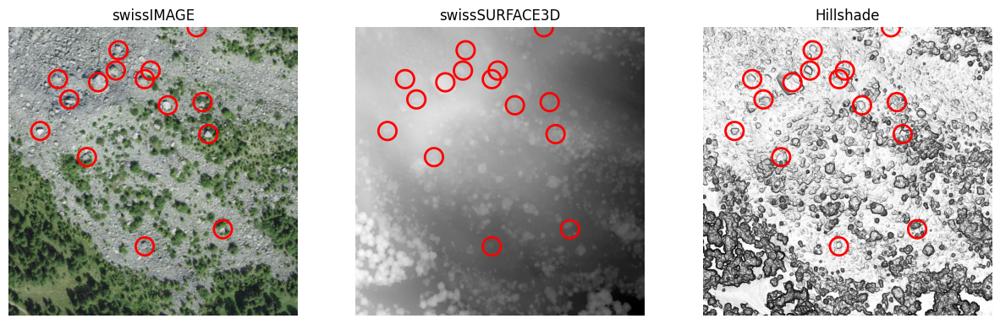

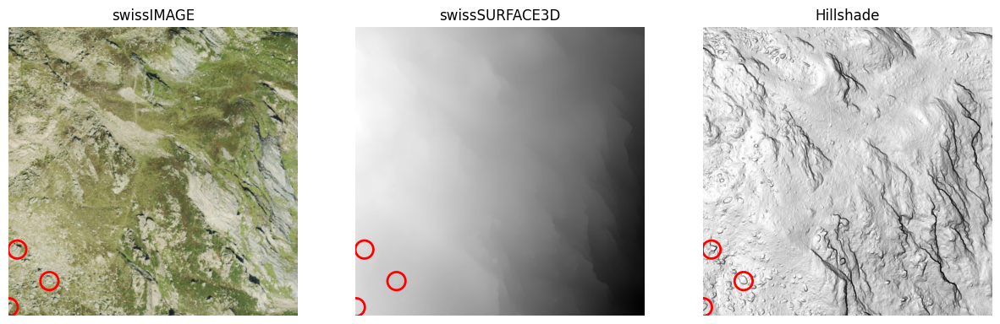

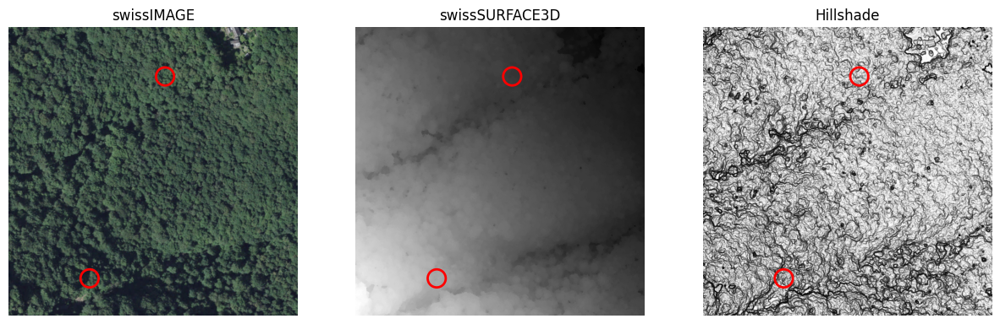

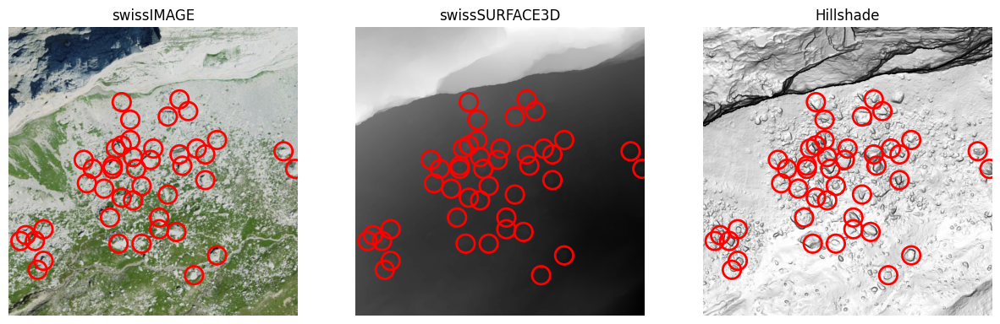

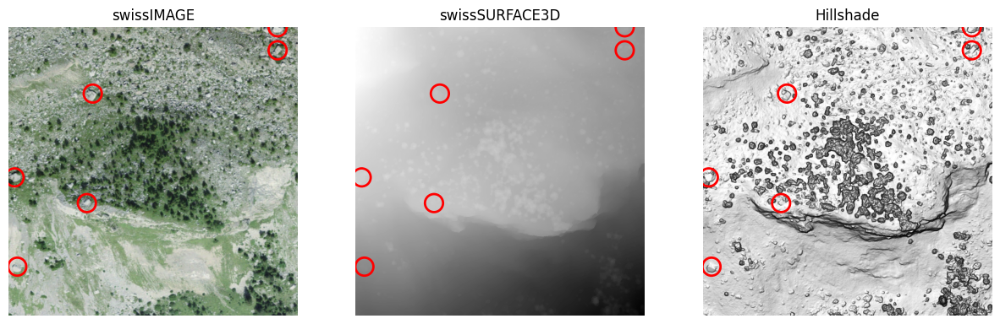

In [11]:
# Paths to non-yolo format datasets:
rgb_folder = "swissImage_50cm_patches"
hillshade_folder = "swissSURFACE3D_hillshade_patches"

# Paths to the YOLO dataset
image_folder = "YOLO/images/train"
label_folder = "YOLO/labels/train"
json_file_path = 'large_rock_dataset.json'

# Load the JSON file
with open(json_file_path, 'r') as file:
    data = json.load(file)

train_data = [tile for tile in data['dataset'] if tile.get('split') == 'train' and tile.get('rocks_annotations')]

for k in range(5):  # Visualize 5 random samples
    random.shuffle(train_data)
    plot_images_with_comparison(train_data[k], label_folder="YOLO/labels/train")

Initial analysis shows that `bbox_size` is never in the large_rock_dataset unlike what is written in Usefull_tips.ipynb provided with the dataset, so the code defaults to our chosen size. [10,10] was too small so we pushed it up to [30,30] to have a similar radius to the one provided. As can be seen in the above images, this seems coherent. These images also permit to verify successful conversion to **YOLO** format.
<br>
This analysis also allows us to visually compare the usefulness of these different layers. We see that the `swissSURFACE3D` seems relatively useless, but `Hillshade` and `swissIMAGE` seem to contain a lot of useful information.

## 3. Testing with manual features

The first idea was to see if it would be possible to manually extract features, rather than use YOLO directly. This could have allowed us to focus on specific, domain-relevant features that might not be captured by generic models like YOLO. Additionally, YOLO requires significant computational resources for training and inference, especially with large datasets. Manually extracting features can be less resource-intensive. To test it, different channels were plotted to see if any segmentation could be done with RGB images. The idea was that potentially gray rocks could be segmented from green forests with some features. Seen from the code below, no segmentation was able to be done.

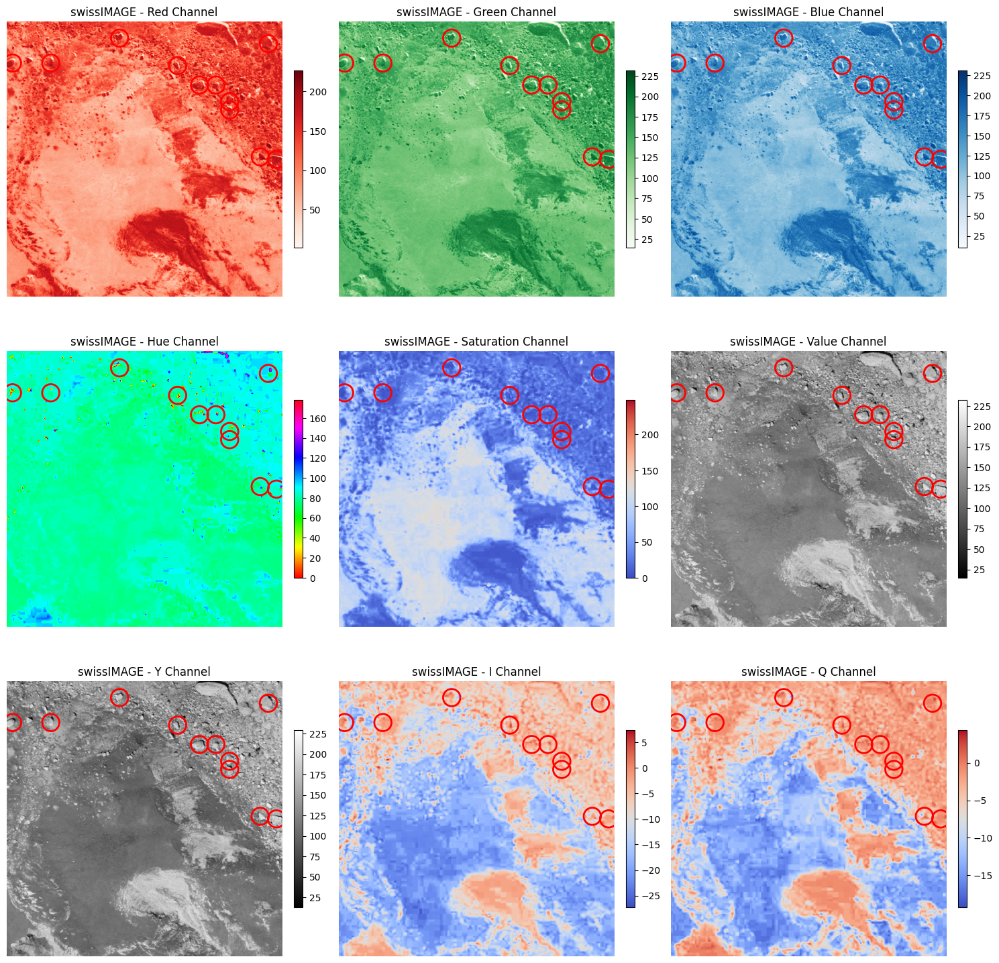

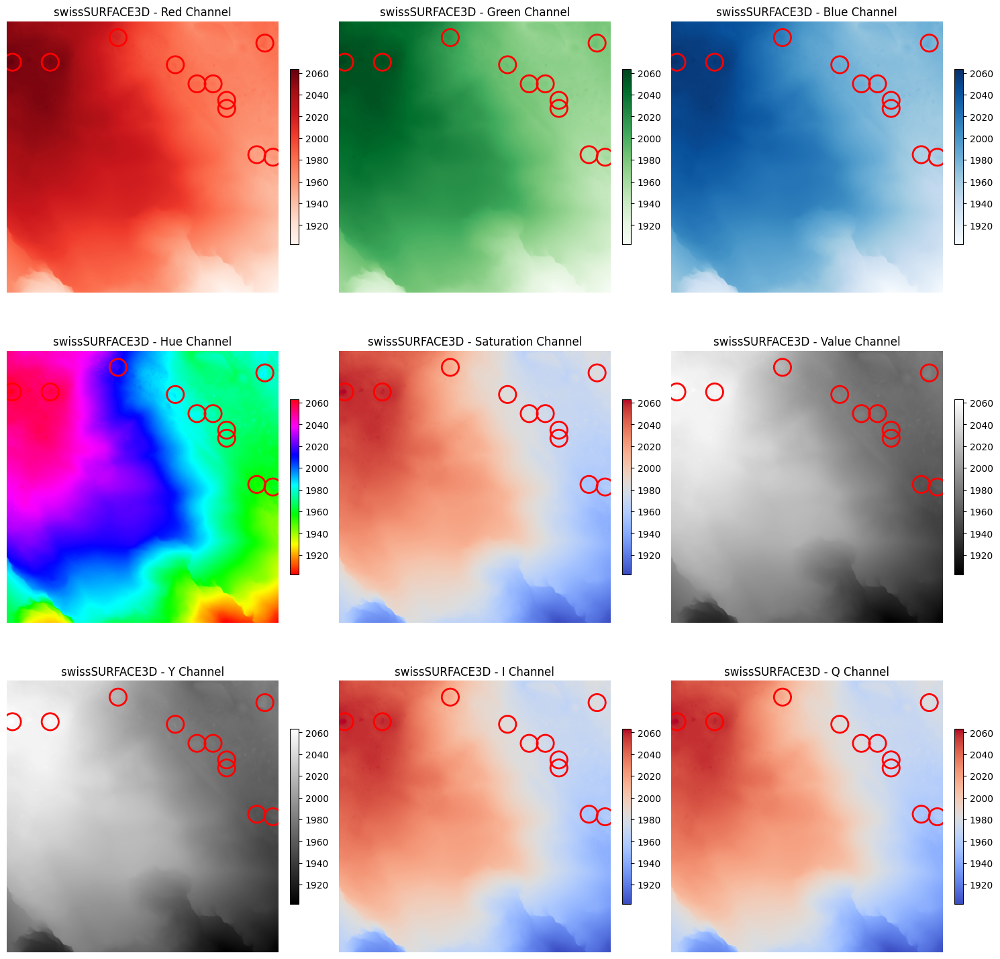

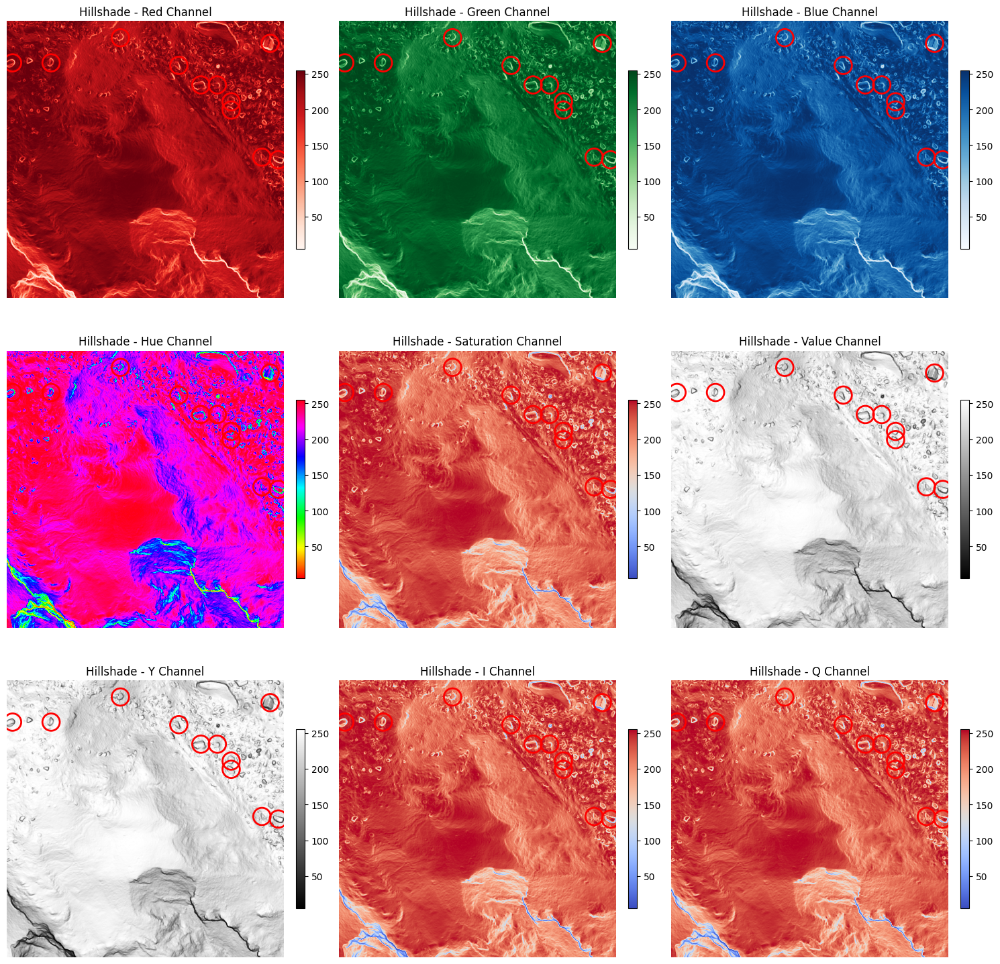

In [12]:
def plot_9_channels_with_bboxes(image, bboxes, title_prefix):

    if len(image.shape) == 2:  # Single-channel image (grayscale)
        B, G, R = image, image, image
        image_hsv = np.stack((image, image, image), axis=-1)  # Create dummy HSV image
        H, S, V = image, image, image
        image_rgb = np.stack((image, image, image), axis=-1)  # Create dummy RGB image
    elif len(image.shape) == 3 and image.shape[2] == 3:  # Multi-channel image (e.g., RGB)
        B, G, R = cv2.split(image)
        image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        H, S, V = cv2.split(image_hsv)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    else:
        raise ValueError("Unsupported image format")

    # Define the transformation matrix from RGB to YIQ
    transform_matrix = np.array([[0.299, 0.587, 0.114],
                                [0.596, -0.274, -0.322],
                                [0.211, -0.523, 0.312]])

    # Apply the transformation matrix
    yiq = np.dot(image_rgb, transform_matrix.T) if len(image.shape) == 3 else np.zeros_like(image_rgb)
    if len(image.shape) == 3:
        yiq[:, :, 1:] = (yiq[:, :, 1:] + 0.5957) / 1.1914  # Normalize I and Q between 0 and 1

    # Prepare figures and axes
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    titles = [f'{title_prefix} - Red Channel', f'{title_prefix} - Green Channel', f'{title_prefix} - Blue Channel',
            f'{title_prefix} - Hue Channel', f'{title_prefix} - Saturation Channel', f'{title_prefix} - Value Channel',
            f'{title_prefix} - Y Channel', f'{title_prefix} - I Channel', f'{title_prefix} - Q Channel']
    channels = [R, G, B, H, S, V, yiq[:, :, 0] if len(image.shape) == 3 else image, 
                yiq[:, :, 1] if len(image.shape) == 3 else image, 
                yiq[:, :, 2] if len(image.shape) == 3 else image]
    cmaps = ['Reds', 'Greens', 'Blues', 'hsv', 'coolwarm', 'gray', 'gray', 'coolwarm', 'coolwarm']

    # Plot each channel
    for i, ax in enumerate(axes.flat):
        im = ax.imshow(channels[i], cmap=cmaps[i])
        ax.set_title(titles[i])
        ax.axis('off')

        # Draw bounding boxes
        for box in bboxes:
            x, y = box['pixel_within_patch_coordinates']
            rect = patches.Circle((x, y), radius=20, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

        cbar = fig.colorbar(im, ax=ax, fraction=0.03, pad=0.04)  # Adjusted colorbar size

    plt.tight_layout()
    plt.show()

def plot_images_and_9_channels(sample_info):
    src_SI = 'swissImage_50cm_patches/' + sample_info['file_name']
    src_SS = 'swissSURFACE3D_patches/' + sample_info['file_name']
    src_HS = 'swissSURFACE3D_hillshade_patches/' + sample_info['file_name']

    # Read and draw the bounding boxes
    bboxes = sample_info['rocks_annotations']

    # Open and process the images
    image_SI = tifffile.imread(src_SI)
    image_SS = tifffile.imread(src_SS)
    image_HS = tifffile.imread(src_HS)

    # Plot the 9 channels for each image with bounding boxes
    plot_9_channels_with_bboxes(image_SI, bboxes, title_prefix='swissIMAGE')
    plot_9_channels_with_bboxes(image_SS, bboxes, title_prefix='swissSURFACE3D')
    plot_9_channels_with_bboxes(image_HS, bboxes, title_prefix='Hillshade')
    
# Shuffle and plot for a random sample
random.shuffle(dataset)
plot_images_and_9_channels(sample_info)

## 4 - Initial YOLO Training

### YOLO model without augmentation and without pretrained weights

Initially we trained a new Yolo model without any augmention and without any pretrained weights. Though from the training run, and the images below, the results werent satisfactory. This approach was chosen to establish a baseline performance, but it became clear that without augmentation and pretrained weights, the model struggled to generalize effectively to the task.

<center>
<img src="Images/WithoutAugmentationWithoutPretrained/WithoutPretrainedWithoutAugmentation.png" width="1000" height="500">
</center>  

### YOLO model without augmentation and with pretrained weights

After training a complete new model, a model using pretrained weights was trained, without any augmnetation. As for the model without augmentation and wihtout pretrained weights, the model seems to be overfitting. The training resolts seems to be roughly 0.1 better than the validation results. The results shown are still not satisfactiroy though.

<center>
<img src="Images/WithAugmentationWithoutPretrained/results_without_pretrained.png" width="1000" height="500">
</center>


### YOLO model with augmentation and without pretrained weights

As the pretrained weights soley did not show any major improvements, only augmentation was added. One moitivation behind only using augmentation was because the dataset that Yolov8 was trained on (COCO dataset) does not actually contain any rock class (as stated here
https://docs.ultralytics.com/datasets/detect/coco/#applications), hence there might have been a misswatch between pretrained model and task. Augmentation was thus added to try and improve the model without augmentation and without pretrained weights.

<center>
<img src="Images/WithAugmentationWithoutPretrained/results_without_pretrained.png" width="1000" height="500">
</center>

### YOLO model with augmentation and with pretrained weights

Training using augmentation and pretrained weights with a 70-20-10 split gives us the following results. The model, despite incorporating both augmentation and pretrained weights, did not show major improvements, though it could be considered the best among the tested approaches from above, hence both augmentation and pretrained weights will be used.

<center>
<img src="Images/WithAugmentationWithPretrained/results.png" width="1000" height="500">
</center>

One potential limitation is that not all data augmentations are equally beneficial for the task, as some may not make sense for the specific context of rock detection. Therefore, the next part will explore various augmentations to identify which ones enhance performance and which ones may not contribute effectively to the model's generalization ability. Another limitation might be the 70-20-10 split.

This simple training was run with the following code:
```python
from ultralytics import YOLO

model = YOLO("yolov8n.pt",task='detect')
results = model.train(data="data.yml", epochs=100, batch=32, imgsz=640)
```

## 5 - Augmentations

When performing augmentation on the dataset, not all augmentation may make sense. Transformation such as flipping, cropping and rotation seem to be applicable for all types of images (RGB and Hillshade). However, changes such as illumination, birghtness and jutter only seem to be suitable for RGB images. One reason copuld be that the pixel values for the hillshade images have specific meanings, such as indication height or shading, whereas for RGB images, only the relationship between the RGB values hold significance.

Image SI Shape: (640, 640, 3)


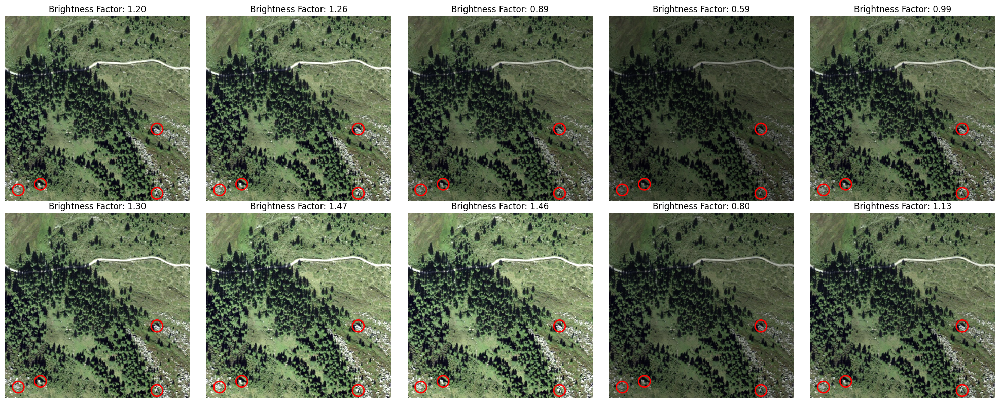

In [19]:
# Apply the brightness augmentation
sample_info = dataset[6]
src_SI = 'swissImage_50cm_patches/' + sample_info['file_name']
bboxes = sample_info['rocks_annotations']
# Read the image
image_SI = tifffile.imread(src_SI)
print("Image SI Shape:", image_SI.shape)

def adjust_brightness(image, brightness_range=(0.5, 1.5)):
    # Convert RGB image to tensor and permute dimensions (H, W, C) -> (C, H, W)
    image_tensor = torch.tensor(image).permute(2, 0, 1)  # Ensure shape is (C, H, W)
    # Sample a random brightness factor
    brightness_factor = random.uniform(*brightness_range)
    # Adjust brightness
    image_aug = transforms.functional.adjust_brightness(image_tensor, brightness_factor)
    return image_aug.permute(1, 2, 0).numpy(), brightness_factor

# Create a 3x3 subplot for different brightness augmentations
fig, ax = plt.subplots(2, 5, figsize=(20, 8))

for i in range(2):
    for j in range(5):
        # Apply random brightness adjustment
        image_SI_aug_np, brightness_factor = adjust_brightness(image_SI)
        # Plot the augmented image
        ax[i, j].imshow(image_SI_aug_np.astype("uint8"))
        ax[i, j].axis("off")
        ax[i, j].set_title(f"Brightness Factor: {brightness_factor:.2f}")
        for box in bboxes:
            x, y = box["pixel_within_patch_coordinates"]
            rect = patches.Circle((x, y), radius=20, linewidth=2, edgecolor="r", facecolor="none")
            ax[i, j].add_patch(rect)

plt.tight_layout()
plt.show()

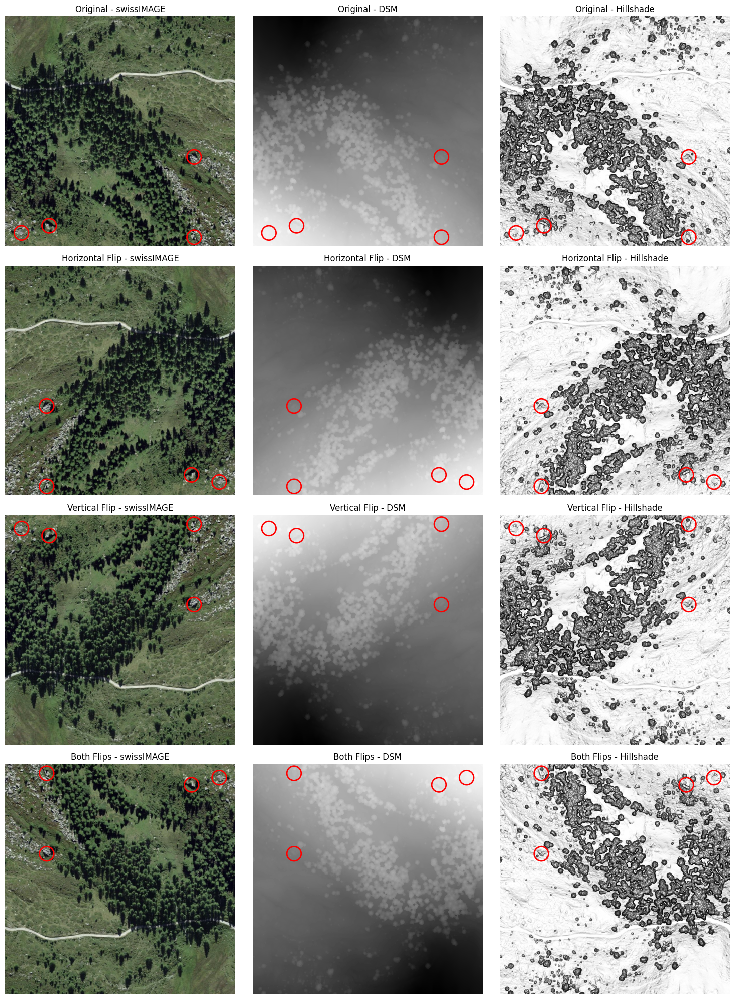

In [20]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tifffile
import numpy as np

def flip_image_and_boxes(image, bboxes, flip_type, image_shape):
    """
    Flip image and adjust bounding boxes.

    Args:
        image: The image array (NumPy array).
        bboxes: List of bounding boxes with pixel coordinates.
        flip_type: 'horizontal', 'vertical', or 'both'.
        image_shape: Tuple containing the shape of the image (height, width).

    Returns:
        Flipped image and updated bounding boxes.
    """
    h, w = image_shape
    flipped_bboxes = []
    
    if flip_type == "horizontal":
        flipped_image = np.fliplr(image)
        for box in bboxes:
            x, y = box['pixel_within_patch_coordinates']
            flipped_bboxes.append({'pixel_within_patch_coordinates': [w - x, y]})
    elif flip_type == "vertical":
        flipped_image = np.flipud(image)
        for box in bboxes:
            x, y = box['pixel_within_patch_coordinates']
            flipped_bboxes.append({'pixel_within_patch_coordinates': [x, h - y]})
    elif flip_type == "both":
        flipped_image = np.fliplr(np.flipud(image))
        for box in bboxes:
            x, y = box['pixel_within_patch_coordinates']
            flipped_bboxes.append({'pixel_within_patch_coordinates': [w - x, h - y]})
    else:
        raise ValueError("flip_type must be 'horizontal', 'vertical', or 'both'")
    
    return flipped_image, flipped_bboxes

# Example data
sample_info = dataset[6]
src_SI = 'swissImage_50cm_patches/' + sample_info['file_name']
src_SS = 'swissSURFACE3D_patches/' + sample_info['file_name']
src_HS = 'swissSURFACE3D_hillshade_patches/' + sample_info['file_name']

image_SI = tifffile.imread(src_SI)
image_SS = tifffile.imread(src_SS)
image_HS = tifffile.imread(src_HS)

bboxes = sample_info['rocks_annotations']

# Flip all images and bounding boxes
flips = {
    "Original": (image_SI, image_SS, image_HS, bboxes),
    "Horizontal": (
        flip_image_and_boxes(image_SI, bboxes, "horizontal", image_SI.shape[:2])[0],
        flip_image_and_boxes(image_SS, bboxes, "horizontal", image_SS.shape[:2])[0],
        flip_image_and_boxes(image_HS, bboxes, "horizontal", image_HS.shape[:2])[0],
        flip_image_and_boxes(image_SI, bboxes, "horizontal", image_SI.shape[:2])[1],
    ),
    "Vertical": (
        flip_image_and_boxes(image_SI, bboxes, "vertical", image_SI.shape[:2])[0],
        flip_image_and_boxes(image_SS, bboxes, "vertical", image_SS.shape[:2])[0],
        flip_image_and_boxes(image_HS, bboxes, "vertical", image_HS.shape[:2])[0],
        flip_image_and_boxes(image_SI, bboxes, "vertical", image_SI.shape[:2])[1],
    ),
    "Both": (
        flip_image_and_boxes(image_SI, bboxes, "both", image_SI.shape[:2])[0],
        flip_image_and_boxes(image_SS, bboxes, "both", image_SS.shape[:2])[0],
        flip_image_and_boxes(image_HS, bboxes, "both", image_HS.shape[:2])[0],
        flip_image_and_boxes(image_SI, bboxes, "both", image_SI.shape[:2])[1],
    ),
}

# Plot the images
f, ax = plt.subplots(4, 3, figsize=(15, 20))

row_titles = ["Original", "Horizontal Flip", "Vertical Flip", "Both Flips"]
col_titles = ["swissIMAGE", "DSM", "Hillshade"]

for row_idx, (flip_type, (image_SI, image_SS, image_HS, bboxes)) in enumerate(flips.items()):
    # swissIMAGE
    ax[row_idx, 0].imshow(image_SI)
    ax[row_idx, 0].set_title(f"{row_titles[row_idx]} - {col_titles[0]}")
    ax[row_idx, 0].axis("off")
    for box in bboxes:
        x, y = box["pixel_within_patch_coordinates"]
        rect = patches.Circle((x, y), radius=20, linewidth=2, edgecolor="r", facecolor="none")
        ax[row_idx, 0].add_patch(rect)
    
    # DSM
    ax[row_idx, 1].imshow(image_SS, cmap="gist_gray")
    ax[row_idx, 1].set_title(f"{row_titles[row_idx]} - {col_titles[1]}")
    ax[row_idx, 1].axis("off")
    for box in bboxes:
        x, y = box["pixel_within_patch_coordinates"]
        rect = patches.Circle((x, y), radius=20, linewidth=2, edgecolor="r", facecolor="none")
        ax[row_idx, 1].add_patch(rect)
    
    # Hillshade
    ax[row_idx, 2].imshow(image_HS, cmap="gist_gray")
    ax[row_idx, 2].set_title(f"{row_titles[row_idx]} - {col_titles[2]}")
    ax[row_idx, 2].axis("off")
    for box in bboxes:
        x, y = box["pixel_within_patch_coordinates"]
        rect = patches.Circle((x, y), radius=20, linewidth=2, edgecolor="r", facecolor="none")
        ax[row_idx, 2].add_patch(rect)

plt.tight_layout()
plt.show()


Random Flip seems to be appropriate to all data types, as the pixel values do not change. Taking all this into account, we decided to customize several augmentation parameters beyond their default settings to enhance model performance. Notably, we ended up setting `hsv_s` (Hue-Saturation-Value Saturation) to 0, deviating from the default value of 0.7, to control color saturation variations. We also disabled certain augmentations by setting `degrees`, `scale`, `shear`, and `perspective` to 0, reducing geometric transformations during training. Additionally, we applied the `randaugment` policy for `auto_augment` and set `erasing` to 0.4, introducing random erasing with a 40% probability to improve model robustness. These deliberate adjustments aimed to tailor the augmentation process to our specific dataset characteristics, potentially enhancing the model's generalization capabilities. A random batch therefore looked like this:

## 6 - Further YOLO Training

After seeing the unsatisfactory results out of part 4, we can already wonder if there is a better way to train the model

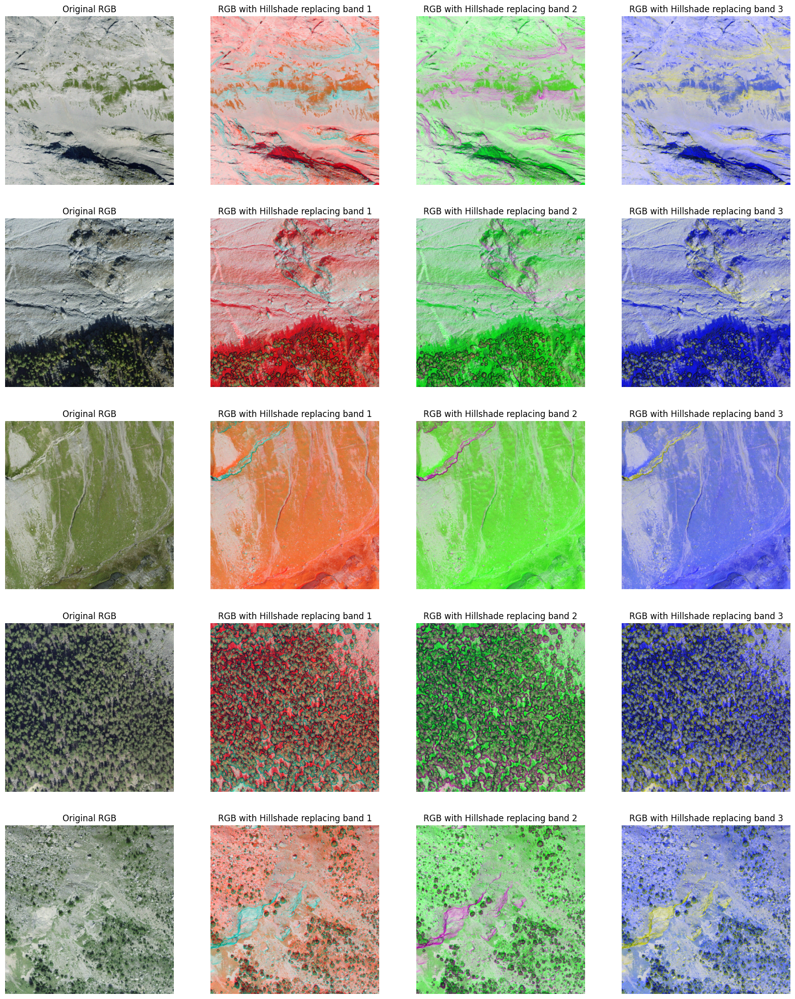

In [13]:
plot_rgb_hillshade_combinations(rgb_folder,hillshade_folder)

Based on these images, initial tests will replace band 2 by hillshade. This seems to, at least visually, provide the least information loss from the rgb data, while displaying the hillshade data the best. The above functions normalises the hillshade values to be within [0,256], then inserts it in place of the different bands, then displays these for 5 images. This is done this way as we haven't found a functional way to incorporate 4 channels in the yolo training yet. The below image displays the comparison between the original RGB images, the RGB image with an exchanged band, and the `.tif` file displaying the RGB with the hillshade as an overlay.

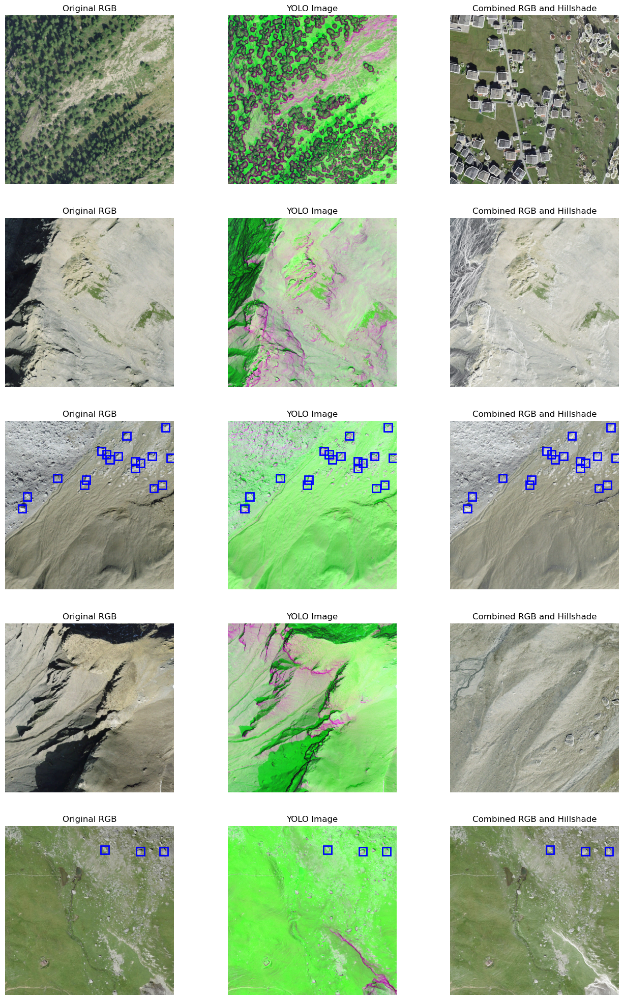

In [15]:
combined_rgb_hillshade_folder = "combined_rgb_hillshade_patches"
label_folder = output_path+'/labels/train'

plot_random_combinations_with_bboxes("YOLO_RGB/images/train", combined_rgb_hillshade_folder,label_folder,yolo_folder='YOLO_RGBHS/images/train')

These modifications allowed us to dramatically improve our results. By using the following settings:

```python
epochs=100, batch=32, imgsz=640, multi_scale=False, overlap_mask=False, mask_ratio=0, dropout=0, iou=0.7, lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=7.5, cls=0.5, dfl=1.5, pose=12.0, kobj=1.0, nbs=64, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0, translate=0.1, scale=0.5, shear=0, perspective=0.0, flipud=0, fliplr=0.5, bgr=0.0, mosaic=0, mixup=0.0, copy_paste=0.0, copy_paste_mode=flip, auto_augment=randaugment, erasing=0.4, crop_fraction=0.5, cfg=None, tracker=botsort.yaml
```
A random batch in the training looked like this:
<center>
<img src="Images/train9/train_batch1.jpg" width="500" height="500">
</center>

And we got the following results



<center>
<img src="Images/train9/results.png" width="1000" height="500">
</center>

As seen in the above image, the results have already improved dramatically, when comparing to the results obtained in the beginning. From the above results, it seems like training was not done yet, which is why the number of epochs was increases to train for longer.

```python
multi_scale=False, overlap_mask=False, mask_ratio=0, dropout=0, iou=0.7, lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=7.5, cls=0.5, dfl=1.5, pose=12.0, kobj=1.0, nbs=64, hsv_h=0.015, hsv_s=0, hsv_v=0.4, degrees=0, translate=0.1, scale=0, shear=0, perspective=0.0, flipud=0, fliplr=0.5, bgr=0.0, mosaic=0, mixup=0.0, copy_paste=0.0, copy_paste_mode=flip, auto_augment=randaugment, erasing=0.4, crop_fraction=0.5, cfg=None, tracker=botsort.yaml, save_dir=runs/detect/train14
```

<center>
<img src="Images/train14/results.png" width="1000" height="500">
</center>


###